In [3]:
import numpy as np
import matplotlib
import sys, platform, os
import matplotlib.cm as cm
import matplotlib.mlab as mlab
import matplotlib.pyplot as plt
import astropy.io.fits as fits
import camb
from scipy.interpolate import interp1d

from camb import model, initialpower
from mpl_toolkits.mplot3d import Axes3D
from ipywidgets import interactive, interact, fixed
from scipy.signal import convolve

from tqdm import tqdm
from tqdm.notebook import tqdm as tqdm_notebook  # Use an alias to avoid conflicts


%config InlineBackend.figure_format = 'retina'
%matplotlib inline

from PolAngle import *
from beam import * 
from map import *
from convolution import * 
from beam_class import *

# Power Spectra

In [5]:
# Read the PS originated from the Common_notebook
Original_PS = np.loadtxt('Original_PS_001.txt')


TT_ps  = Original_PS[0]
TE_ps  = Original_PS[1]
EE_ps  = Original_PS[2]
BB_ps  = Original_PS[3]
BB_ps_tensor  = Original_PS[4]



#plot the total CMB power spectra
ls = np.arange(TT_ps.shape[0])

# Maps

In [6]:
# MAP PARAMETERS

pix_size         = 0.5                              #arcmin
N                = 2**10                            #num pixel lineare
X_width, Y_width = N*pix_size/60., N*pix_size/60.   #dimensioni mappa in gradi
Nsqdeg           = X_width**2

c_min, c_max     = -200, 200                        #color map

print(f"Map with {N} x {N} pixels, each of {pix_size} arcmin, for a total dimension of {X_width:.2f} x {Y_width:.2f} gradi")


nbig = 5000

Map with 1024 x 1024 pixels, each of 0.5 arcmin, for a total dimension of 8.53 x 8.53 gradi


In [7]:
# ORIGINAL MAPS

ell_big = np.arange(nbig)

TT_ps_big = np.zeros(nbig)
TT_ps_big[ls.astype(int)] = TT_ps

EE_ps_big = np.zeros(nbig)
EE_ps_big[ls.astype(int)] = EE_ps

BB_ps_big = np.zeros(nbig)
BB_ps_big[ls.astype(int)] = BB_ps

TE_ps_big = np.zeros(nbig)
TE_ps_big[ls.astype(int)] = TE_ps

ell    = ell_big
ps_TT  = TT_ps_big + 1e-3   
ps_EE  = EE_ps_big + 1e-3
ps_BB  = BB_ps_big + 1e-3
ps_TE  = TE_ps_big

Temp_point_source_spectrum = ps_TT[1000]*(ell/3000.)**2.
Pol_point_source_spectrum  = ps_EE[1500]*(ell/4500.)**2.

ps_TT = ps_TT + Temp_point_source_spectrum  
ps_EE = ps_EE + Pol_point_source_spectrum
ps_BB = ps_BB + Pol_point_source_spectrum



T_map, Q_map, U_map, E_map, B_map = make_CMB_maps(N,pix_size,ell,ps_TT,ps_EE,ps_TE,ps_BB)

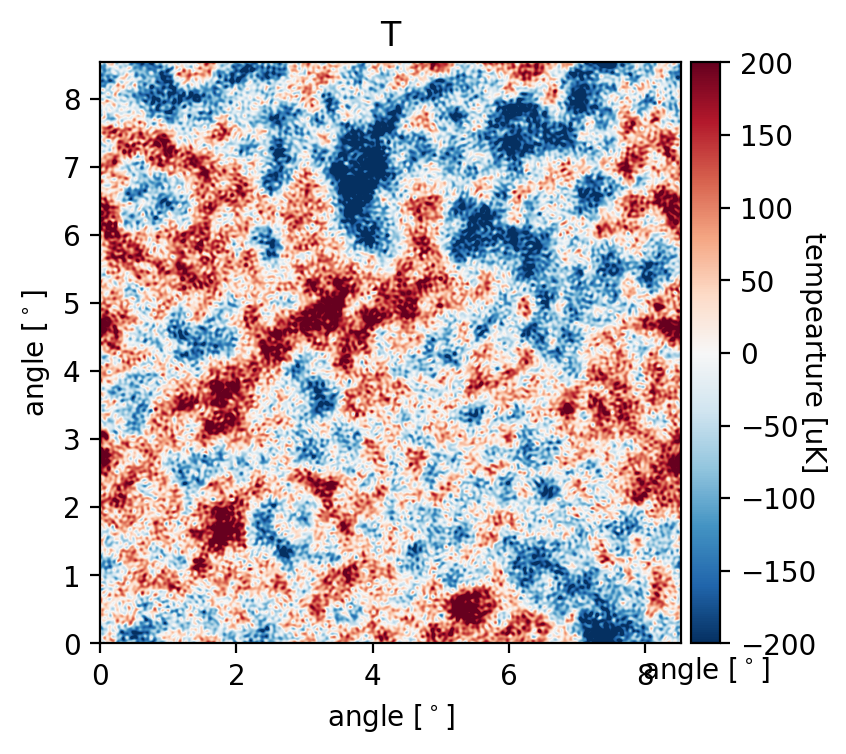

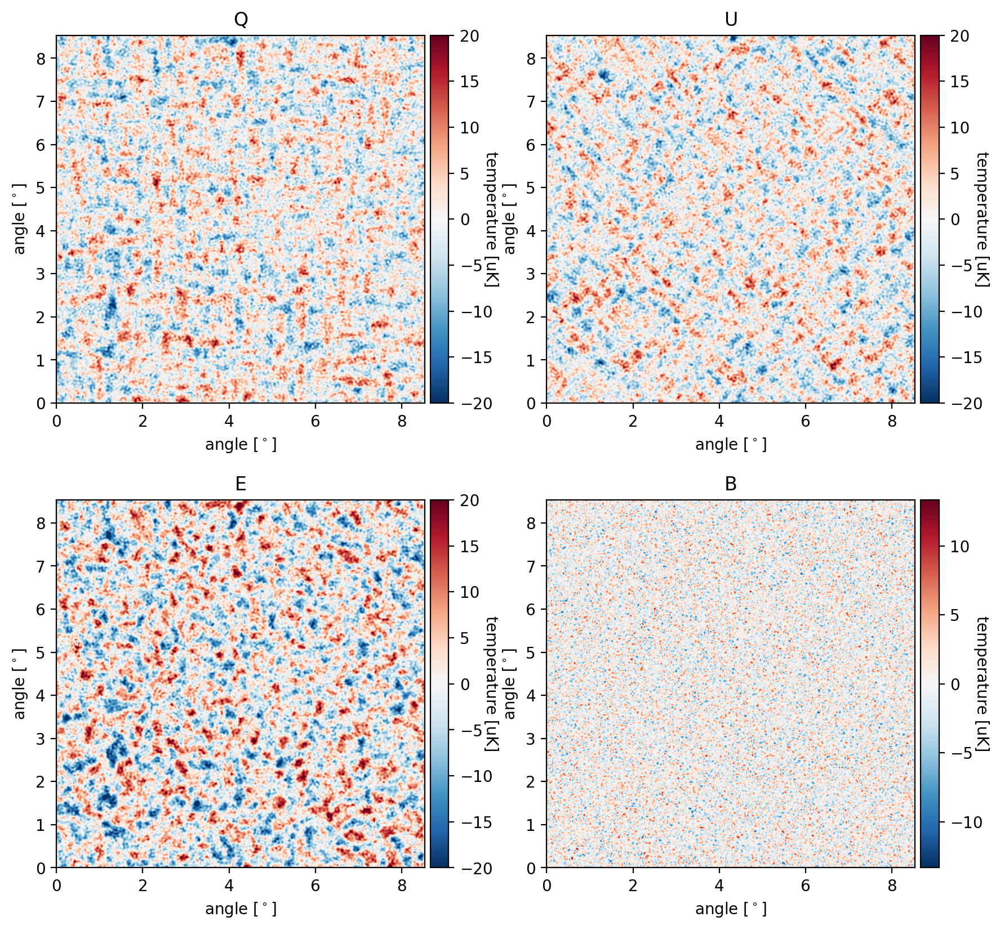

In [8]:
plt.title("T")
plt.ylabel('angle $[^\circ]$')
plt.xlabel('angle $[^\circ]$')
p = Plot_CMB_Map(T_map,c_min,c_max,X_width,Y_width)



Map_to_Plot = [Q_map, U_map, E_map, B_map]
title = ["Q","U","E", "B"]
c_factor = [10, 10, 10,15]

fig, axs = plt.subplots(2, 2, figsize=(9, 9))
axs      = axs.flatten()
for i, (map_data, c_factor_iter) in enumerate(zip(Map_to_Plot, c_factor)):
        Plot_CMB_Map_compact(axs[i], map_data, c_min/c_factor_iter, c_max/c_factor_iter, X_width, Y_width)
        axs[i].set_title(title[i])

plt.tight_layout()
plt.subplots_adjust(wspace=0.25, hspace=0.2, top=0.90)
#plt.suptitle('Maps convolution with beam', fontsize=20)
plt.show()

# Beam
Simulation of a realistic beam with a gaussian center peak and secondary peaks
https://github.com/McMahonCosmologyGroup/cmbInstrumentSummerSchool/blob/main/Notebook2_beam_systematics.ipynb

In [11]:
# COORDINATES LIKE THE ONES OF THE MAPS

N = int(N)
ones = np.ones(N)
inds = (np.arange(N)+.5 - N/2.) * pix_size
X = np.outer(ones,inds)
Y = np.transpose(X)
R = np.sqrt(X**2. + Y**2.)


#####################################################################################

# VARIABLES

FWHM_x = 15  #degrees
FWHM_y = 30  #degrees
ellipticity = (FWHM_x - FWHM_y) / (FWHM_x + FWHM_y)
print("ellipticity = ", ellipticity)

array_dB = np.array([-20, -22,  -24, -26, -28, -30])  #max values of the secondary peaks
array_dB = array_dB *1.5
r1 = np.array([30, 55, 90, 120, 150, 200]) #angular distance of the peaks
r = 4 # width of the rings

theta = 0 # angle of rotation of the beam
a = 1 # major axis of ellipses 


#########################################################################################

# BEAM

beam_gauss_x, beam_gauss_y, sec_rings_x,sec_rings_y, beam_x, beam_y = create_beam_secpeaks(pix_size, FWHM_x, FWHM_y, theta, array_dB, r, r1, X, Y, a, ellipticity)

ellipticity =  -0.3333333333333333


beam max: 4.342923104481638e-05 beam min: 4.569732565621859
beam max: 4.342923104481638e-05 beam min: 4.56973256562186


0

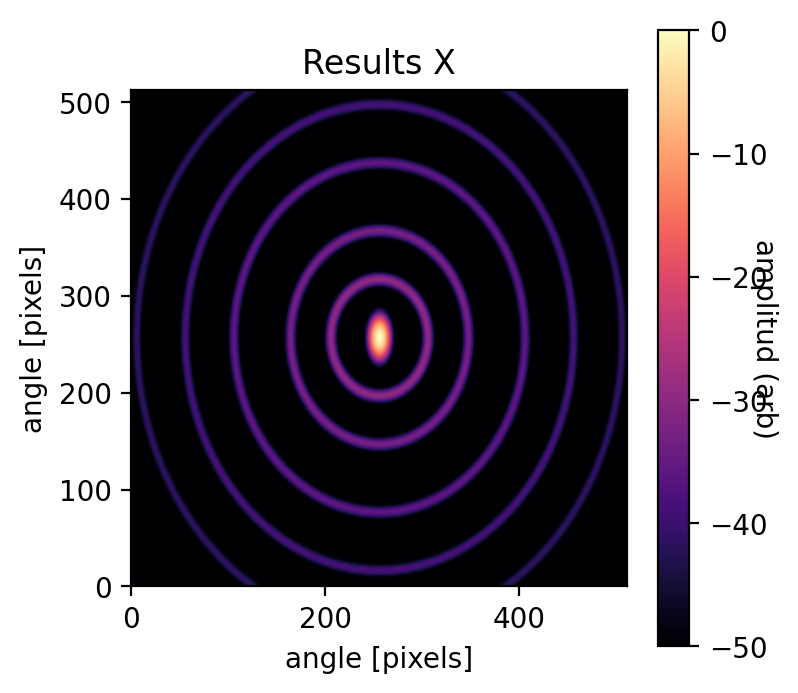

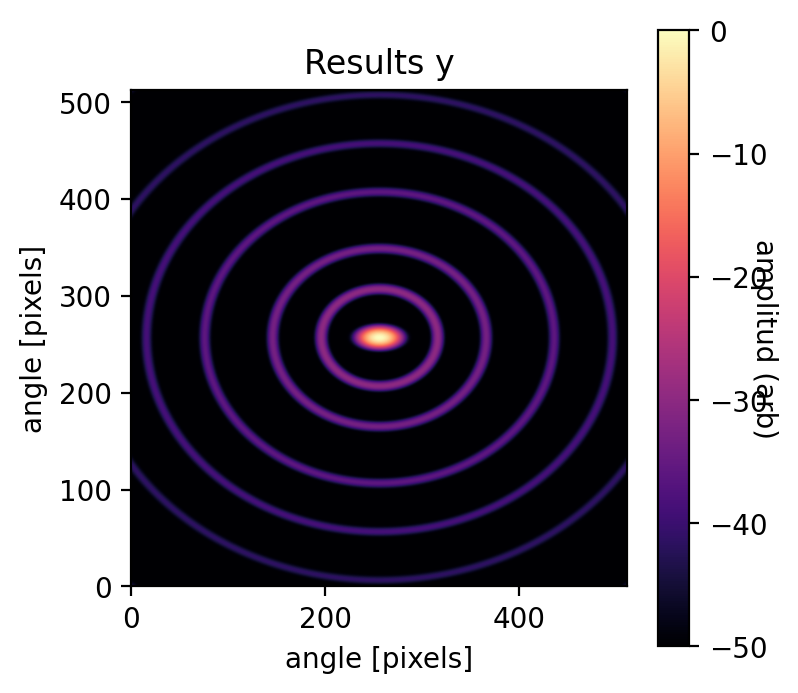

In [12]:
beam_to_plot = beam_x
beam_to_plot = beam_to_plot / np.max(beam_to_plot) + 1e-5
beam_to_plot = 10. * np.log10(beam_to_plot)
Plot_beam(beam_to_plot,np.min(beam_to_plot),np.max(beam_to_plot),N,pix_size,512, "Results X", "angle [pixels]")

beam_to_plot = beam_y
beam_to_plot = beam_to_plot / np.max(beam_to_plot) + 1e-5
beam_to_plot = 10. * np.log10(beam_to_plot)
Plot_beam(beam_to_plot,np.min(beam_to_plot),np.max(beam_to_plot),N,pix_size,512, "Results y", "angle [pixels]")

### Beam systematics

In [13]:
### beam systematics dictionary
bs = {"budy":{"A":1e-3,"FWHP":1.5,"R":30.,"psi":0.3,"polfracQ":0.5,"polfracU":0.01},  
                                                                         # little budy amplitude, 
                                                                         #FWHP, offset spacing, rotationa angle (radians)
                                                                        # pol_fraction for Q and U
     "ghostshelf": {"A":1e-4,"Diam":20.,"roll_off":7.},    #model of ghosting, amplitude (A), diameter (Diam) 
     "hex_crostalk":{"grid_space": 2.5,"N":5,"neighbor_exp_fall":0.01}, 
                                                                               ## model of optical cross talk 
                                                                               ## to detectors on a hex grid
                                                                               ## assumed to be exponetial
                                                                               ## assumed to be 50% polarized
      "TtoQ":{"mono":1e-3,"dip_x":1e-2,"dip_y":1e-2,"quad_x":1e-2,"quad_45":1e-2},
      "TtoU":{"mono":1e-3,"dip_x":1e-2,"dip_y":1e-2,"quad_x":1e-2,"quad_45":1e-2},
                                                                  ## multiplole expansion leakage
      'psi':0.01*np.pi/180.
                                  ## detetor angle rotations
                   }

beam max: 4.342923104481638e-05 beam min: 4.599382434602043
beam max: 4.342923104481638e-05 beam min: 4.597384404763201
beam max: 4.342923104481638e-05 beam min: 4.597384404763201
beam max: 4.342923104481638e-05 beam min: 4.9244534866352705
beam max: 4.342923104481638e-05 beam min: 4.918712820098119


0

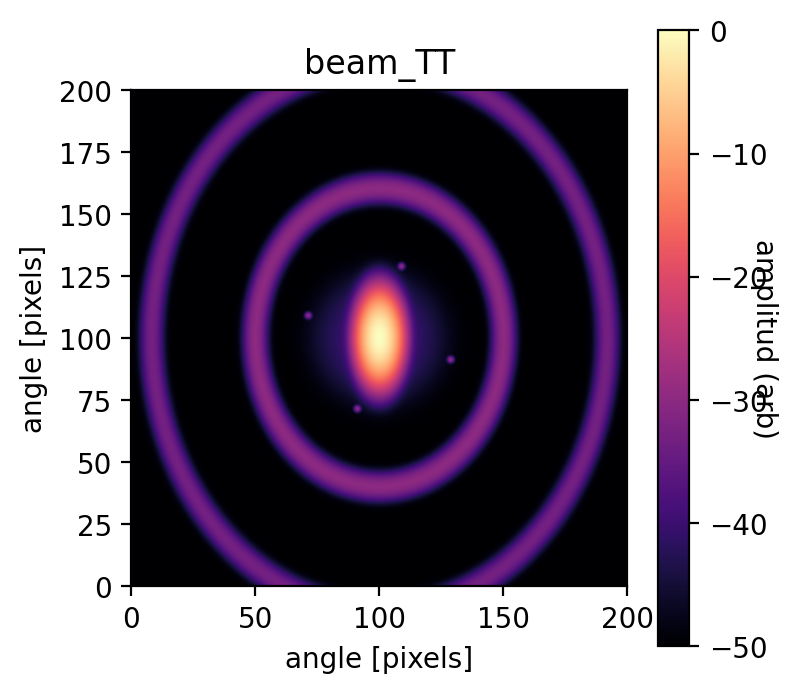

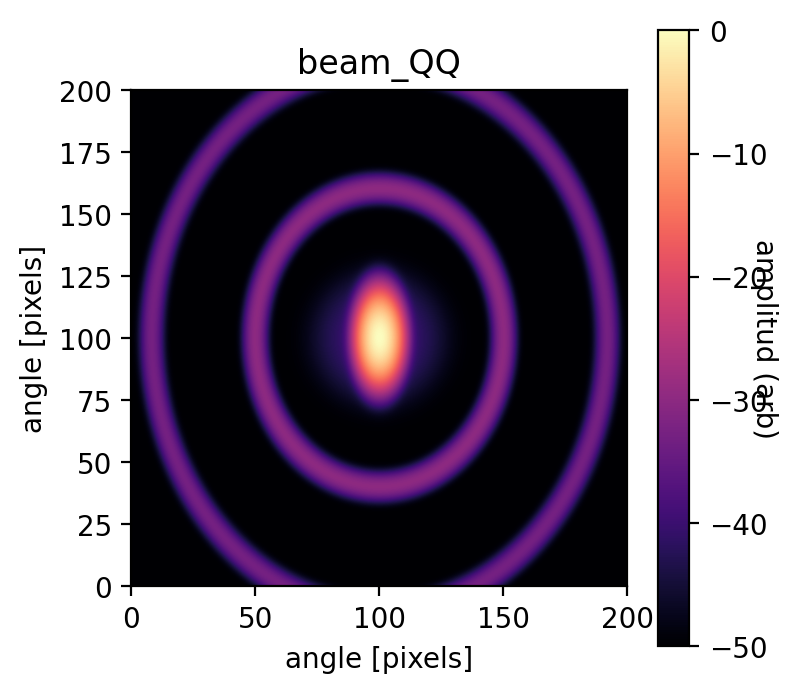

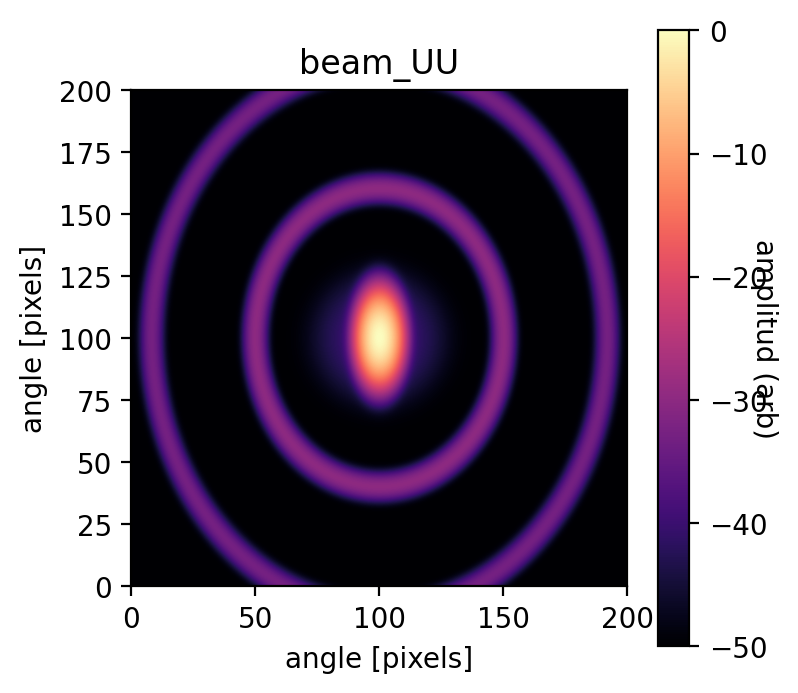

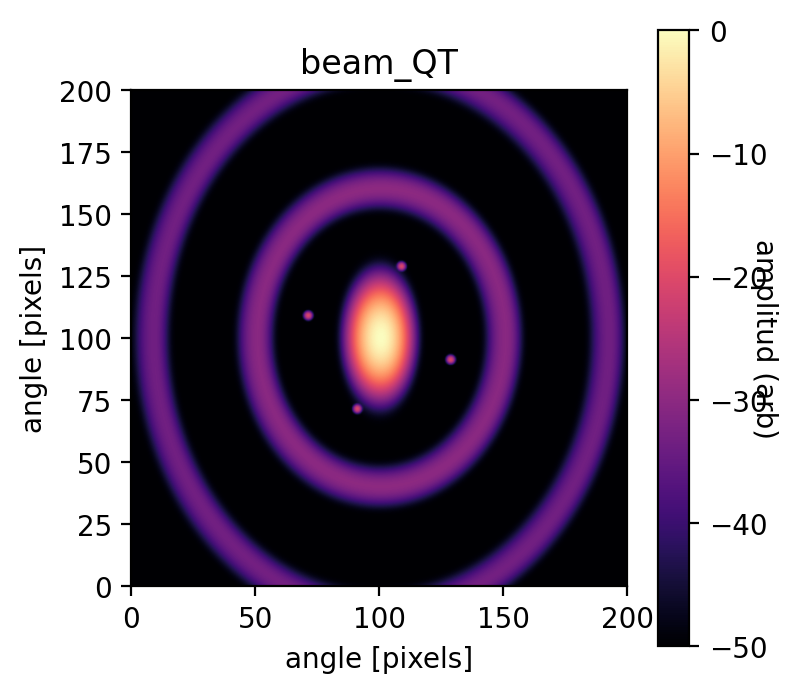

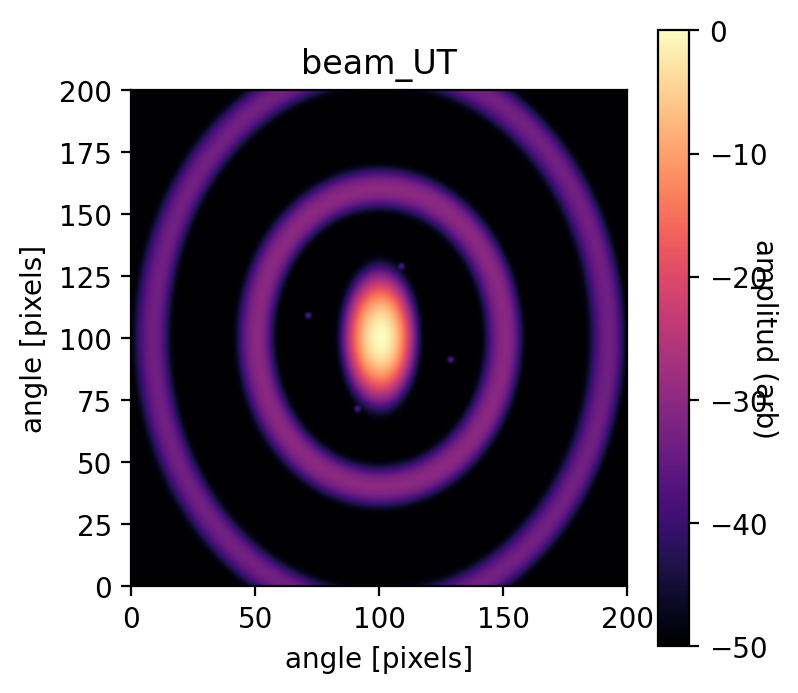

In [14]:
beam_sys = BeamSystematics()
beam_TT, beam_QQ, beam_UU, beam_QT, beam_UT, beam_QU, beam_UQ = beam_sys.make_systematics_beams(N, pix_size, FWHM_x, beam_x, bs)


######################################################################################################################################
beam_to_plot = beam_TT
beam_to_plot = beam_to_plot / np.max(beam_to_plot) + 1e-5
beam_to_plot = 10. * np.log10(beam_to_plot)
Plot_beam(beam_to_plot,np.min(beam_to_plot),np.max(beam_to_plot),N,pix_size,200, "beam_TT", 'angle [pixels]')

beam_to_plot = beam_QQ
beam_to_plot = beam_to_plot / np.max(beam_to_plot) + 1e-5
beam_to_plot = 10. * np.log10(beam_to_plot)
Plot_beam(beam_to_plot,np.min(beam_to_plot),np.max(beam_to_plot),N,pix_size,200, "beam_QQ", 'angle [pixels]')
                                                            
beam_to_plot = beam_UU
beam_to_plot = beam_to_plot / np.max(beam_to_plot) + 1e-5
beam_to_plot = 10. * np.log10(beam_to_plot)
Plot_beam(beam_to_plot,np.min(beam_to_plot),np.max(beam_to_plot),N,pix_size,200,"beam_UU", 'angle [pixels]')


beam_to_plot = beam_QT
if np.any(beam_to_plot <= 0):
    beam_to_plot[beam_to_plot <= 0] = 1e-21
beam_to_plot = beam_to_plot / np.max(beam_to_plot) + 1e-5
beam_to_plot = 10. * np.log10(beam_to_plot)
Plot_beam(beam_to_plot,np.min(beam_to_plot),np.max(beam_to_plot),N,pix_size,200,"beam_QT", 'angle [pixels]')

beam_to_plot = beam_UT
beam_to_plot = beam_to_plot / np.max(beam_to_plot) + 1e-5
if np.any(beam_to_plot <= 0):
    beam_to_plot[beam_to_plot <= 0] = 1e-21
beam_to_plot = 10. * np.log10(beam_to_plot)
Plot_beam(beam_to_plot,np.min(beam_to_plot),np.max(beam_to_plot),N,pix_size,200,"beam_UT", 'angle [pixels]')

### Convolve map with beam

In [15]:
## MAPS IN THE REAL SPACE

# convolution with perfect beam
perf_beam, no1, no2, no3, no4, no5 = create_beam_secpeaks(pix_size, FWHM_x, FWHM_y, 0, array_dB, r, r1, X, Y, a, ellipticity)
perf_beam = perf_beam / np.sum(perf_beam)

Q_conv_perf = convolve_map_with_beam(Q_map, perf_beam)
U_conv_perf = convolve_map_with_beam(U_map, perf_beam)


# convolution with real beam
Q_conv_real = convolve_map_with_beam(Q_map, beam_QQ)
U_conv_real = convolve_map_with_beam(U_map, beam_UU)

# POLARIZATION ANGLE SYSTEMATICS

In [23]:
std_deviation_degree = 1
std_deviation_rad   = std_deviation_degree * np.pi / 180
gauss_center  = 0

print(std_deviation_rad)

0.017453292519943295


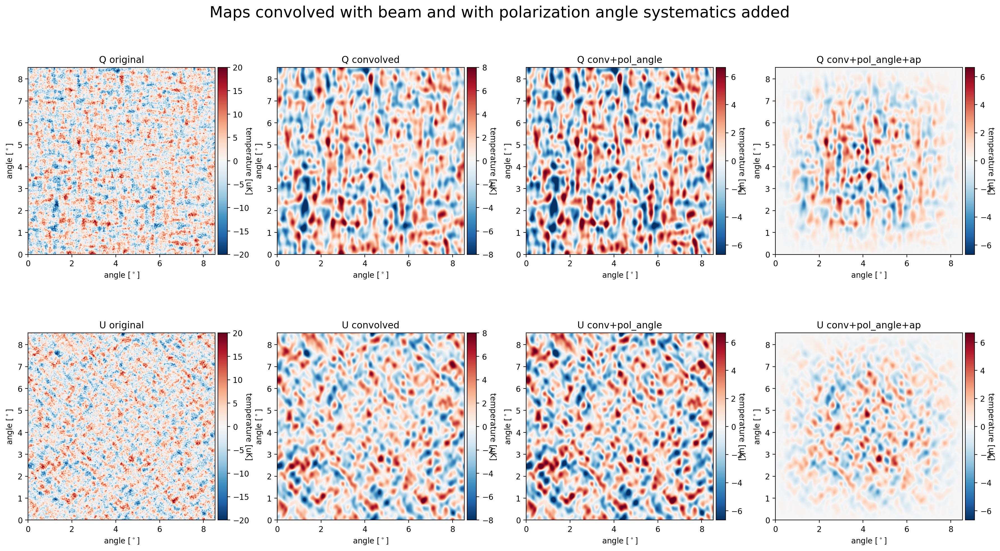

In [24]:
# POLARIZATION ANGLE
 
Q_pert, U_pert = polangle_map(Q_conv_real, U_conv_real, gauss_center, std_deviation_rad)
#Q_map_pert_perf, U_map_pert_perf = polangle_map(Q_conv_perf, U_conv_perf, gauss_center, std_deviation_rad)

########################################################################################################

# APODIZATION
window = (cosine_window(N))
Q_ap = window * Q_pert
U_ap = window * U_pert

########################################################################################################

# plot
Map_to_Plot = [Q_map, Q_conv_real,Q_pert,Q_ap, U_map, U_conv_real ,U_pert, U_ap]
title = ["Q original","Q convolved","Q conv+pol_angle", "Q conv+pol_angle+ap", "U original","U convolved", "U conv+pol_angle", "U conv+pol_angle+ap"]
c_factor = [10, 25, 30,30, 10, 25,30, 30]

fig, axs = plt.subplots(2, 4, figsize=(18, 10))
axs      = axs.flatten()
for i, (map_data, c_factor_iter) in enumerate(zip(Map_to_Plot, c_factor)):
        Plot_CMB_Map_compact(axs[i], map_data, c_min/c_factor_iter, c_max/c_factor_iter, X_width, Y_width)
        axs[i].set_title(title[i])

plt.tight_layout()
plt.subplots_adjust(wspace=0.25, hspace=0.2, top=0.90)
plt.suptitle('Maps convolved with beam and with polarization angle systematics added', fontsize=20)
plt.show()

# ANALYSIS

### Deconvolution

In [25]:
#Q_deconv = deconvolve_map(Q_ap/window, beam_QQ, perf_beam)
#U_deconv = deconvolve_map(U_ap/window, beam_UU, perf_beam)

Q_deconv = correct_lr(Q_ap/window, perf_beam,N, pix_size, 'onestep', None, 1e-10, 1e-12, None, 50)
U_deconv = correct_lr(U_ap/window, perf_beam,N, pix_size, 'onestep', None, 1e-10, 1e-12, None, 50)

In [26]:
# DIFFERENCE
Q_diff = (Q_conv_perf- Q_deconv)
U_diff = (U_conv_perf- U_deconv)

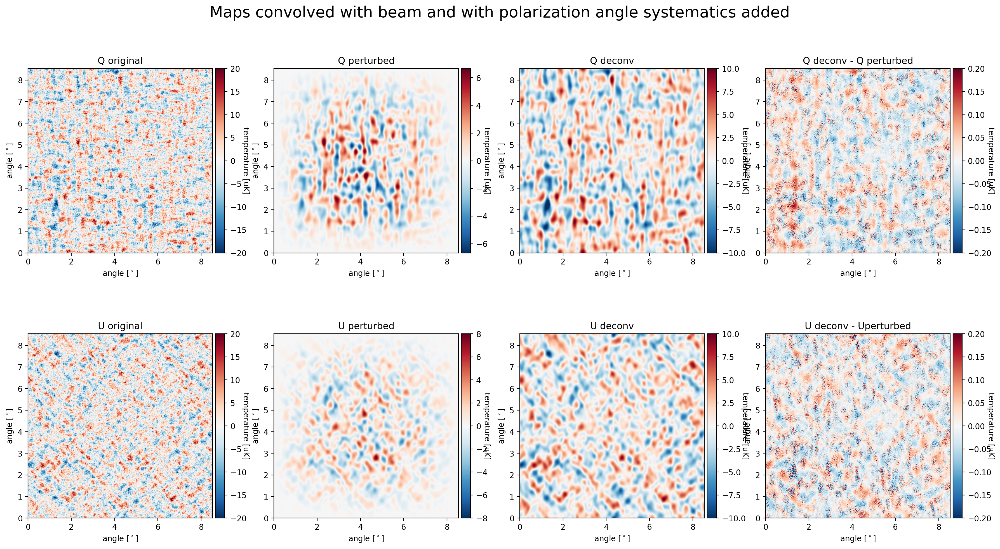

In [27]:
# plot
Map_to_Plot = [Q_map,Q_ap, Q_deconv, Q_diff, U_map, U_ap, U_deconv, U_diff]
title = ["Q original", "Q perturbed", "Q deconv", "Q deconv - Q perturbed", "U original","U perturbed", "U deconv", "U deconv - Uperturbed"]
c_factor = [10,30, 20, 1e3, 10, 25,20, 1e3]

fig, axs = plt.subplots(2, 4, figsize=(18, 10))
axs      = axs.flatten()
for i, (map_data, c_factor_iter) in enumerate(zip(Map_to_Plot, c_factor)):
        Plot_CMB_Map_compact(axs[i], map_data, c_min/c_factor_iter, c_max/c_factor_iter, X_width, Y_width)
        axs[i].set_title(title[i])

plt.tight_layout()
plt.subplots_adjust(wspace=0.25, hspace=0.2, top=0.90)
plt.suptitle('Maps convolved with beam and with polarization angle systematics added', fontsize=20)
plt.show()

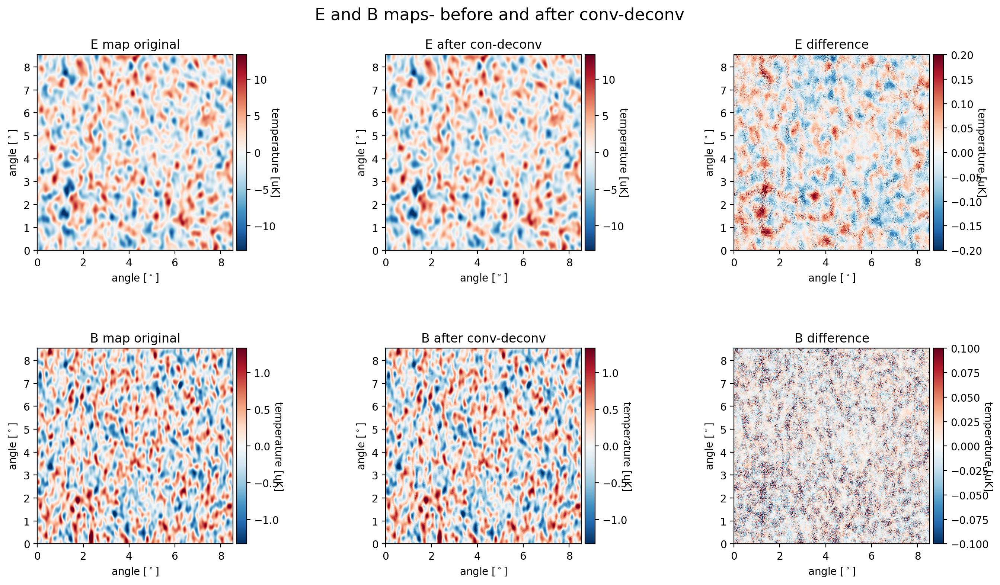

In [38]:
# FROM QU TO EB (beam + pol_angle)
E_deconv, B_deconv = QU2EB(N,pix_size,Q_deconv,U_deconv)

E_diff, B_diff     = QU2EB(N,pix_size,Q_diff,U_diff)

E_conv, B_conv     = QU2EB(N,pix_size,Q_conv_perf,U_conv_perf)

#E_conv = convolve_map_with_beam(E_map, perf_beam)
#B_conv = convolve_map_with_beam(B_map, perf_beam)



map_list      = [E_conv, E_deconv, E_diff, B_conv, B_deconv, B_diff] 
title_list    = ["E map original", "E after con-deconv", "E difference", "B map original", "B after conv-deconv", "B difference"]
color_rescale = [15, 15, 1e3, 150, 150, 2e3]

fig, axs = plt.subplots(2, 3, figsize=(15, 8))
axs      = axs.flatten()

for i, map_data in enumerate(map_list):

        Plot_CMB_Map_compact(axs[i], map_data, c_min/color_rescale[i], c_max/color_rescale[i], X_width, Y_width)
        axs[i].set_title(title_list[i])
        
        
plt.tight_layout()
plt.subplots_adjust(wspace=0, hspace=0.5, top=0.90)
plt.suptitle('E and B maps- before and after conv-deconv', fontsize=16)
plt.show()

In [39]:
delta_l = 50.
l_max   = 2500

# Power spectra deconvolved maps
binned_l_E_deconv, binned_spectrum_E_deconv = calculate_2d_spectrum(E_deconv,E_deconv,delta_l,l_max,pix_size,N)
binned_l_B_deconv, binned_spectrum_B_deconv = calculate_2d_spectrum(B_deconv,B_deconv,delta_l,l_max,pix_size,N)

# Power spectra difference maps - to obtain the side lobes
binned_l_Ediff, binned_spectrum_Ediff = calculate_2d_spectrum(E_diff,E_diff,delta_l,l_max,pix_size,N)
binned_l_Bdiff, binned_spectrum_Bdiff = calculate_2d_spectrum(B_diff,B_diff,delta_l,l_max,pix_size,N)

# Power spectra of maps convolved with a perfect beam to compare better with the deconvolved power spectra
binned_l_E_conv, binned_spectrum_E_conv = calculate_2d_spectrum(E_conv,E_conv,delta_l,l_max,pix_size,N)
binned_l_B_conv, binned_spectrum_B_conv = calculate_2d_spectrum(B_conv,B_conv,delta_l,l_max,pix_size,N)

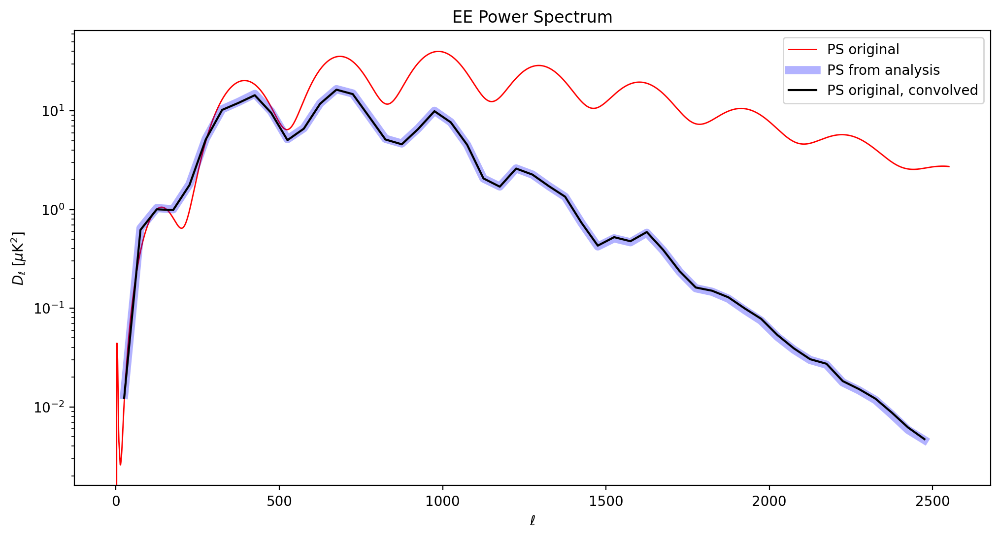

In [40]:
# EE
plt.figure(figsize=(12, 6))

# PS originale da camb
plt.semilogy(ls,Original_PS[2], label="PS original", c="r", linewidth=1)

# PS dalle mappe convolute - deconvolute con beam con sistematiche
plt.semilogy(binned_l_E_deconv, binned_spectrum_E_deconv* binned_l_E_deconv * (binned_l_E_deconv+1.)/2. / np.pi,color='b', alpha=0.3, linewidth =6,label="PS from analysis")

# PS da mappe quasi originali, perchè convolute con un beam perfetto
plt.semilogy(binned_l_E_conv, binned_spectrum_E_conv* binned_l_E_conv * (binned_l_E_conv+1.)/2. / np.pi,color='black', label="PS original, convolved")




plt.title("EE Power Spectrum")
plt.ylabel('$D_{\ell}$ [$\mu$K$^2$]')
plt.xlabel('$\ell$')
plt.legend()

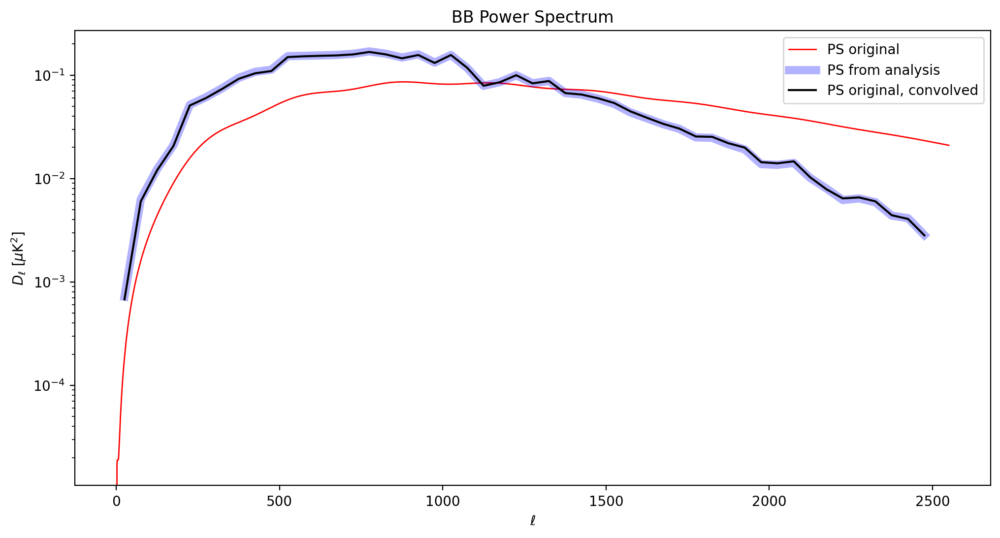

In [41]:
# BB
plt.figure(figsize=(12, 6))

# PS originale da camb
plt.semilogy(ls,Original_PS[3], label="PS original", c="r", linewidth=1)

# PS dalle mappe convolute - deconvolute con beam con sistematiche
plt.semilogy(binned_l_B_deconv, binned_spectrum_B_deconv* binned_l_B_deconv * (binned_l_B_deconv+1.)/2. / np.pi,color='b', alpha=0.3, linewidth =6,label="PS from analysis")

# PS da mappe quasi originali, perchè convolute con un beam perfetto
plt.semilogy(binned_l_B_conv, binned_spectrum_B_conv* binned_l_B_conv * (binned_l_B_conv+1.)/2. / np.pi,color='black', label="PS original, convolved")



plt.title("BB Power Spectrum")
plt.ylabel('$D_{\ell}$ [$\mu$K$^2$]')
plt.xlabel('$\ell$')
plt.legend()

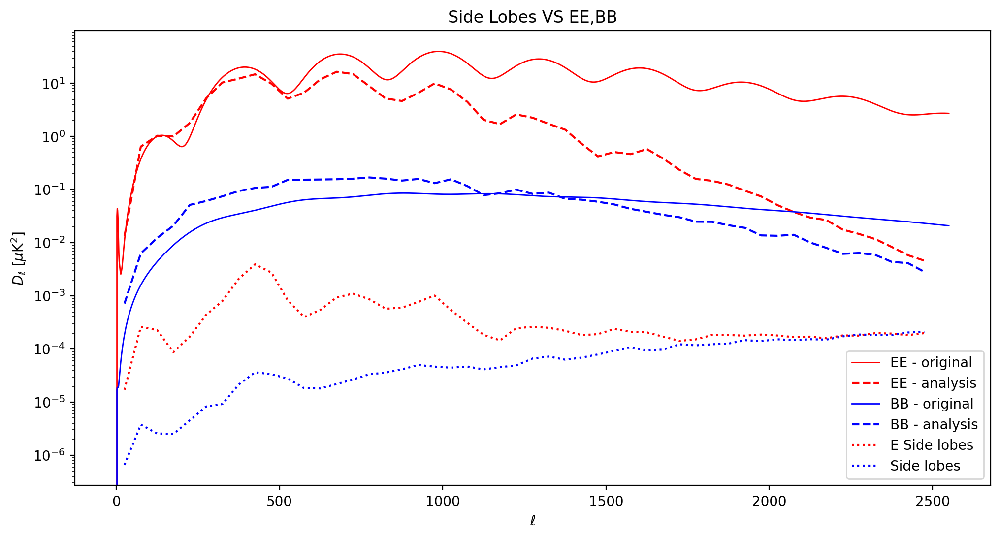

In [42]:
plt.figure(figsize=(12, 6))

# EE
plt.semilogy(ls,Original_PS[2], label="EE - original", c="r", linewidth=1)
plt.semilogy(binned_l_E_deconv, binned_spectrum_E_deconv* binned_l_E_deconv * (binned_l_E_deconv+1.)/2. / np.pi,color='r', linestyle="--",label="EE - analysis")

#BB
plt.semilogy(ls,Original_PS[3], label="BB - original", c="b", linewidth=1)
plt.semilogy(binned_l_B_deconv, binned_spectrum_B_deconv* binned_l_B_deconv * (binned_l_B_deconv+1.)/2. / np.pi,color='b', linestyle="--", label="BB - analysis")

# SIDE LOBES
plt.semilogy(binned_l_Ediff, binned_spectrum_Ediff* binned_l_Ediff * (binned_l_Ediff+1.)/2. / np.pi,color='red', linestyle=":", label="E Side lobes")
plt.semilogy(binned_l_Bdiff, binned_spectrum_Bdiff* binned_l_Bdiff * (binned_l_Bdiff+1.)/2. / np.pi,color='blue', linestyle=":", label="Side lobes")



plt.title("Side Lobes VS EE,BB")
plt.ylabel('$D_{\ell}$ [$\mu$K$^2$]')
plt.xlabel('$\ell$')
plt.legend()